In [1]:
%load_ext autoreload
%autoreload 2

In [11]:
import random
import numpy as np
import torchvision.transforms.functional as F
from torch.nn import Module
from matplotlib import pyplot as plt
from pathlib import Path
from PIL import Image
from torchvision.utils import make_grid
from timm.data import create_transform, rand_augment_transform
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from tqdm import tqdm

from data.transforms import Shrink, CenterCropPct


plt.rcParams["savefig.bbox"] = 'tight'

In [3]:
def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), figsize=(15, 15), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

In [4]:
img_size = 512
image_dir = Path("/workspace/data/images_page_7/0/")
filenames = list(image_dir.glob("*.png"))

create_transform(
    input_size=img_size,
    is_training=False,
    crop_pct=0.95
)

Compose(
    Resize(size=538, interpolation=bilinear, max_size=None, antialias=warn)
    CenterCrop(size=(512, 512))
    ToTensor()
    Normalize(mean=tensor([0.4850, 0.4560, 0.4060]), std=tensor([0.2290, 0.2240, 0.2250]))
)

In [6]:
np.array(Image.open(filenames[0])).shape

(688, 1479, 3)

In [21]:
n_pixels, sum_pixels, sum_pixels_sq = 0, None, None
for filename in tqdm(filenames):
    img = np.array(Image.open(filename))
    img = img.astype(float) / 255

    n_pixels += (img.shape[0] * img.shape[1])
    if sum_pixels is None:
        sum_pixels = img.sum((0, 1)) 
    else: 
        sum_pixels = sum_pixels + img.sum((0, 1))
    if sum_pixels_sq is None:
        sum_pixels_sq = (img ** 2).sum((0, 1))
    else:
        sum_pixels_sq = sum_pixels_sq + (img ** 2).sum((0, 1))

n_pixels, sum_pixels, sum_pixels_sq

100%|██████████| 1129/1129 [01:08<00:00, 16.55it/s]


(1088370263,
 array([1.01627409e+09, 9.88890361e+08, 9.98800107e+08]),
 array([9.57980262e+08, 9.17414677e+08, 9.31827733e+08]))

In [22]:
total_mean = sum_pixels / n_pixels
total_std  = sum_pixels_sq / n_pixels - total_mean ** 2

total_mean, total_std

(array([0.93375767, 0.90859737, 0.9177025 ]),
 array([0.00829363, 0.01737597, 0.01399008]))

In [36]:
t_original = Compose(
    [
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
        # Normalize(mean=total_mean, std=total_std)
    ]
)
t_raw = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
        # Normalize(mean=total_mean, std=total_std)
    ]
)
t_shrink = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Shrink(scale=None),
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
        # Normalize(mean=total_mean, std=total_std)
    ]
)
t_aug = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Shrink(scale=None),
        Resize(size=(img_size, img_size)),
        rand_augment_transform(
            config_str='rand-m9-mstd0.5',
            hparams=dict(img_mean=tuple(int(m * 255) for m in total_mean))
        ),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
        # Normalize(mean=total_mean, std=total_std)
    ]
)

In [40]:
tuple(int(m * 255) for m in total_mean)

(238, 231, 234)

In [34]:
t_original, t_raw, t_shrink, t_aug

(Compose(
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.93375767 0.90859737 0.9177025 ], std=[0.00829363 0.01737597 0.01399008])
 ),
 Compose(
     CenterCropPct(size=(0.9, 0.9))
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.93375767 0.90859737 0.9177025 ], std=[0.00829363 0.01737597 0.01399008])
 ),
 Compose(
     CenterCropPct(size=(0.9, 0.9))
     Shrink(scale=None)
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     ToTensor()
     Normalize(mean=[0.93375767 0.90859737 0.9177025 ], std=[0.00829363 0.01737597 0.01399008])
 ),
 Compose(
     CenterCropPct(size=(0.9, 0.9))
     Shrink(scale=None)
     Resize(size=(512, 512), interpolation=bilinear, max_size=None, antialias=warn)
     RandAugment(n=2, ops=
 	AugmentOp(name=AutoContrast, p=0.5, m=9, mstd=0.5)
 	AugmentOp(name=Equalize, p=0.5, m=9, m

In [26]:
filenames_sample = [random.sample(filenames, 9) for _ in range(10)]

['2mivi1li', 'yy0szf2e', 'k9jn7pdi', 'o6qbfsgz', '08iwwo8m', 'jg5exovl', 'bzfmf5v8', '0xqvhhhv', '05eq9f1y']
['4cyzecqy', 'drav1dv1', 'wibciyhg', '49crwssd', '7ut5a7t2', 'uj49228j', 'jooskyzv', 'uuggf1s7', '7x1hf8sh']
['qbc0z2sl', 'xiyoa66c', 'drav1dv1', 'w09gztun', 'eyfwsnwd', 'q4n9djkb', '9jclx9f7', 'hgxkiur9', 'eh408snl']
['70j26gp1', 'kg8k1bx3', 'pjrr6vxc', '3kfl6a36', 'oxk5y262', '8bt9si2a', 'qhw4vc8o', 'uucqw2cn', 'xsy0atf6']
['s4xs6gtk', 'rr4gq7zb', 'gawgxzga', 'f662smhw', '984x0rw9', '6jn7wrbc', 'i0aosocx', '9kdswl4l', 'xgrxhsxv']
['0jamx18o', 'uuggf1s7', 'bzfmf5v8', 'retnlce0', 'jb68woac', 'ussw5ei1', 'vhbby3u4', 'nv7n6c5c', 'x82yrtsb']
['jvghvndp', 'oxk5y262', 'e3xwx1iz', 'lrbcgqxg', 'shk81e70', 'd71zazk9', 'sy3z8ynh', 'jr32nvbx', '1n705ef8']
['3jrrivie', 'qrimite8', 'v47a2cp5', '1ojip5y7', '45u3in6d', 'aiv94oe5', 'jxro26uk', 'o2vpwyez', '5vg96jxq']
['mn1uc7ly', 'sycpjk8q', 'yh4wyluf', '984x0rw9', 'sp14j73t', '6t5gt51a', '9zooe7y1', 'dbdfsmgk', '3j7c1ors']
['ub642c2t', '38daj

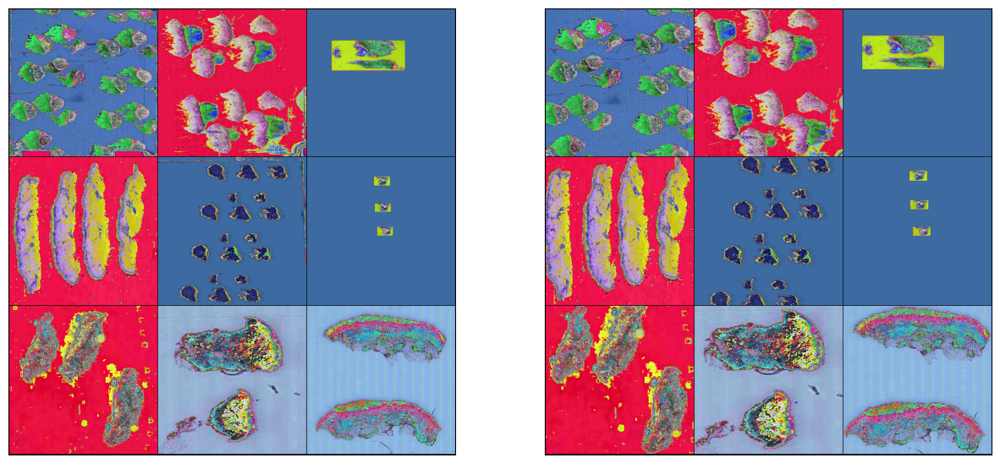

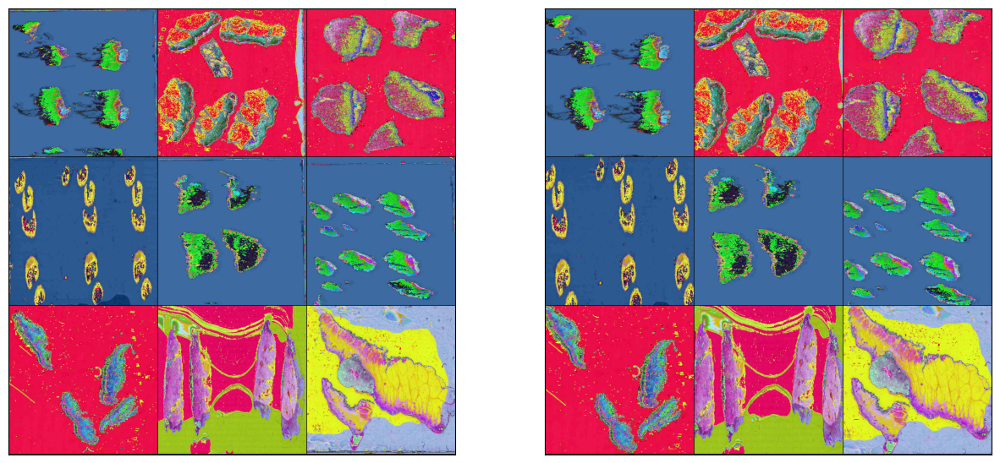

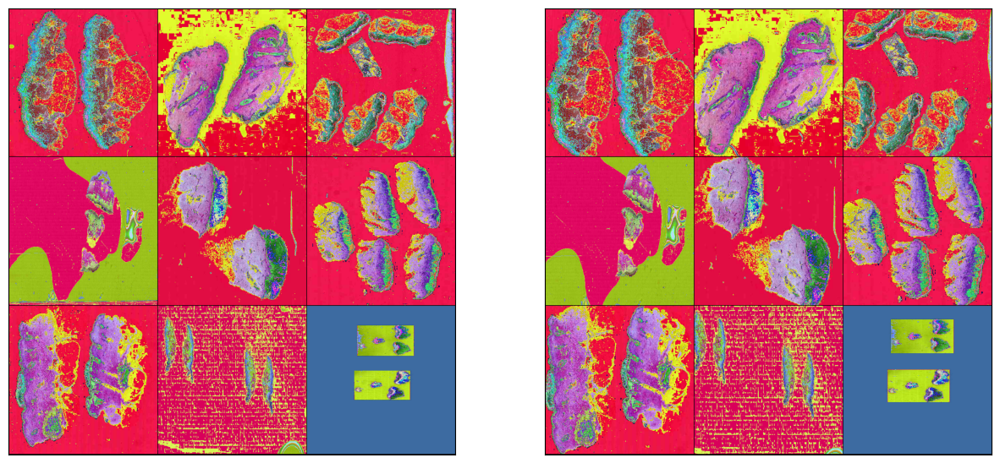

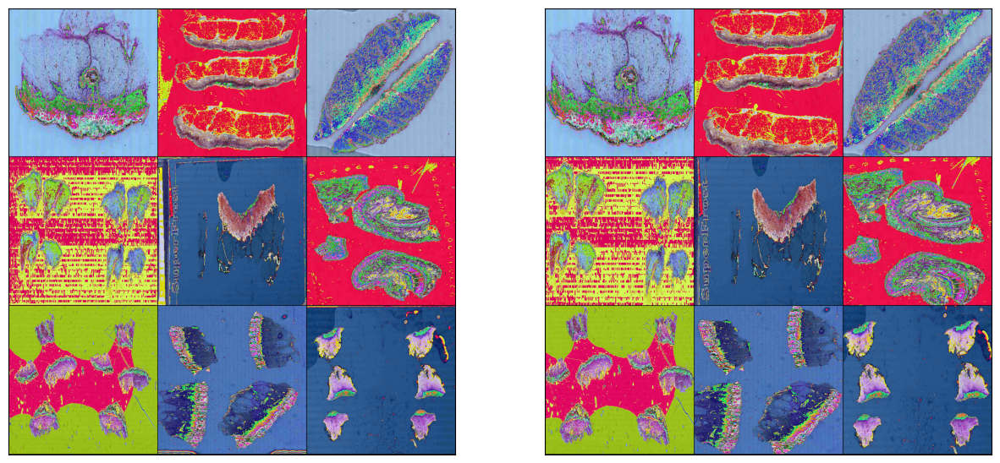

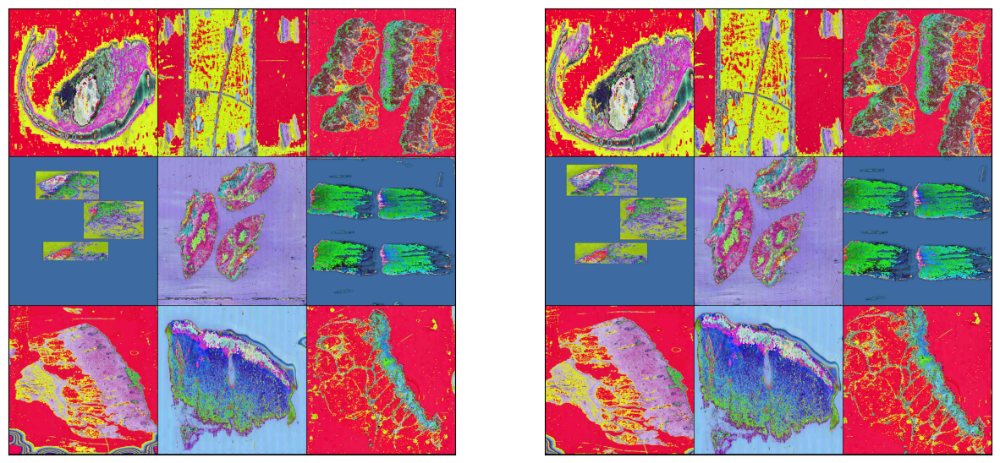

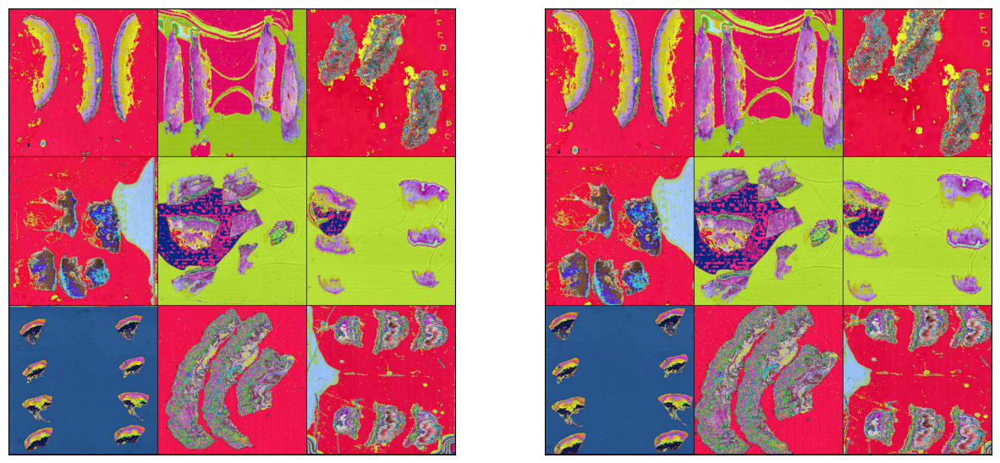

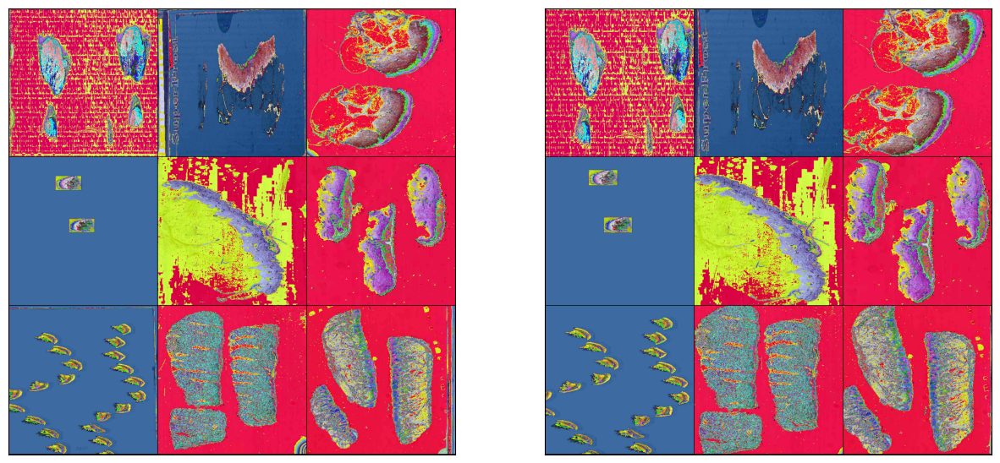

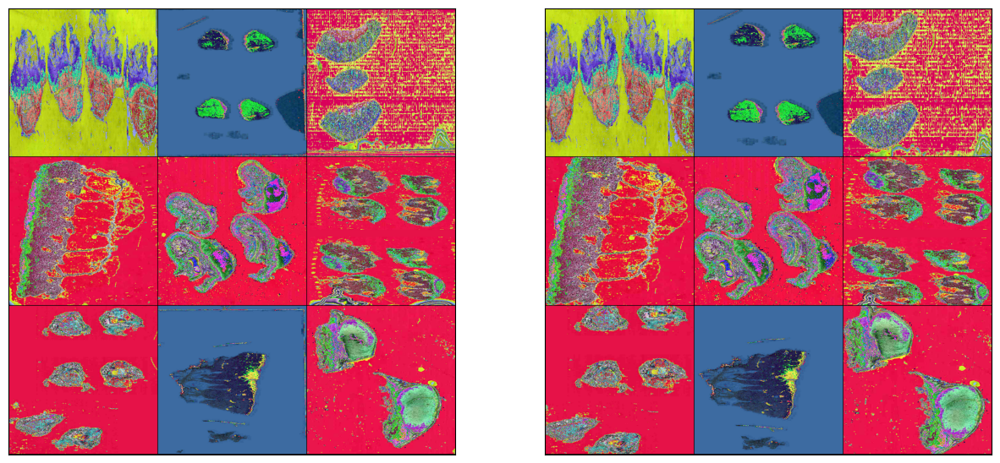

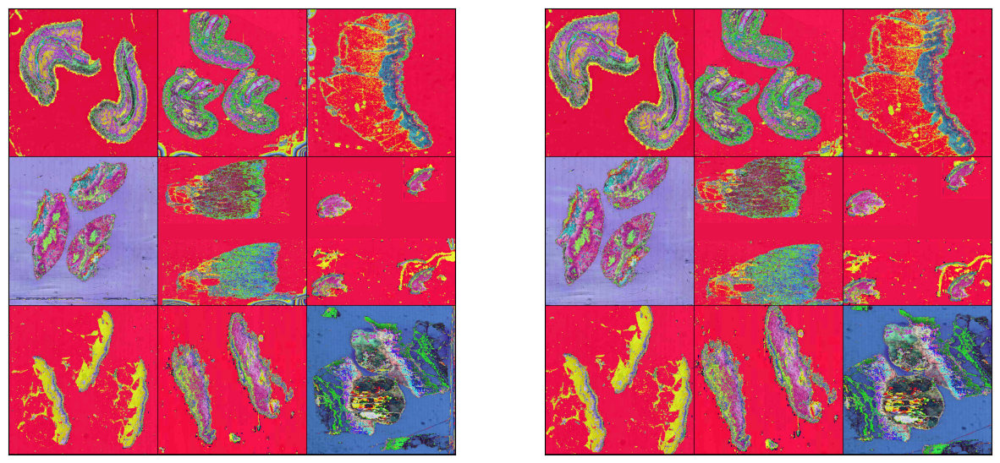

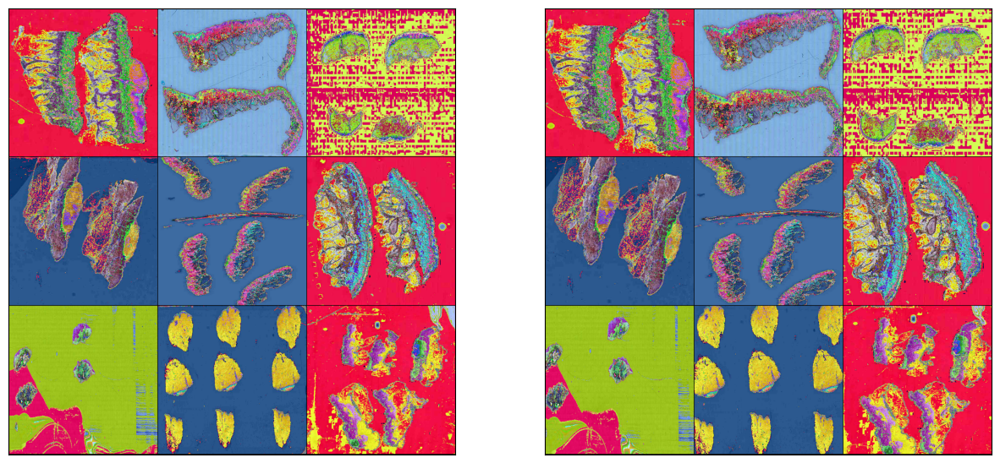

In [37]:
for sample in filenames_sample:
    images_original = [t_original(Image.open(filename)) for filename in sample]
    images_raw = [t_raw(Image.open(filename)) for filename in sample]

    grid_original = make_grid(images_original, nrow=3)
    grid_raw = make_grid(images_raw, nrow=3)

    names = [str(x.stem) for x in sample]
    print(names)
    show([grid_original, grid_raw])

['2mivi1li', 'yy0szf2e', 'k9jn7pdi', 'o6qbfsgz', '08iwwo8m', 'jg5exovl', 'bzfmf5v8', '0xqvhhhv', '05eq9f1y']
['4cyzecqy', 'drav1dv1', 'wibciyhg', '49crwssd', '7ut5a7t2', 'uj49228j', 'jooskyzv', 'uuggf1s7', '7x1hf8sh']
['qbc0z2sl', 'xiyoa66c', 'drav1dv1', 'w09gztun', 'eyfwsnwd', 'q4n9djkb', '9jclx9f7', 'hgxkiur9', 'eh408snl']
['70j26gp1', 'kg8k1bx3', 'pjrr6vxc', '3kfl6a36', 'oxk5y262', '8bt9si2a', 'qhw4vc8o', 'uucqw2cn', 'xsy0atf6']
['s4xs6gtk', 'rr4gq7zb', 'gawgxzga', 'f662smhw', '984x0rw9', '6jn7wrbc', 'i0aosocx', '9kdswl4l', 'xgrxhsxv']
['0jamx18o', 'uuggf1s7', 'bzfmf5v8', 'retnlce0', 'jb68woac', 'ussw5ei1', 'vhbby3u4', 'nv7n6c5c', 'x82yrtsb']
['jvghvndp', 'oxk5y262', 'e3xwx1iz', 'lrbcgqxg', 'shk81e70', 'd71zazk9', 'sy3z8ynh', 'jr32nvbx', '1n705ef8']
['3jrrivie', 'qrimite8', 'v47a2cp5', '1ojip5y7', '45u3in6d', 'aiv94oe5', 'jxro26uk', 'o2vpwyez', '5vg96jxq']
['mn1uc7ly', 'sycpjk8q', 'yh4wyluf', '984x0rw9', 'sp14j73t', '6t5gt51a', '9zooe7y1', 'dbdfsmgk', '3j7c1ors']
['ub642c2t', '38daj

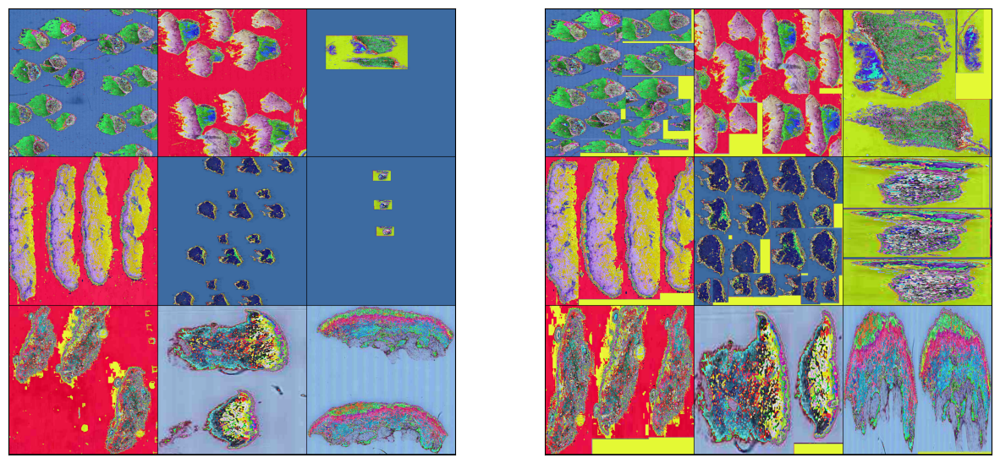

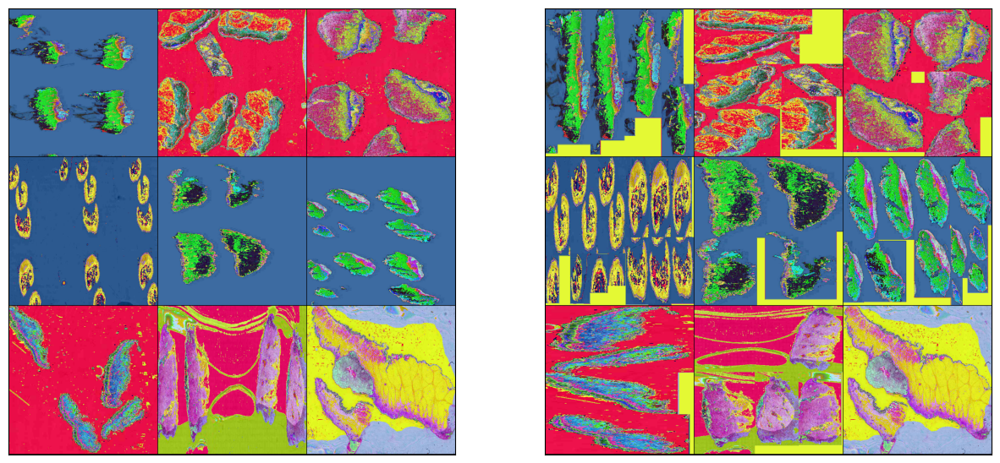

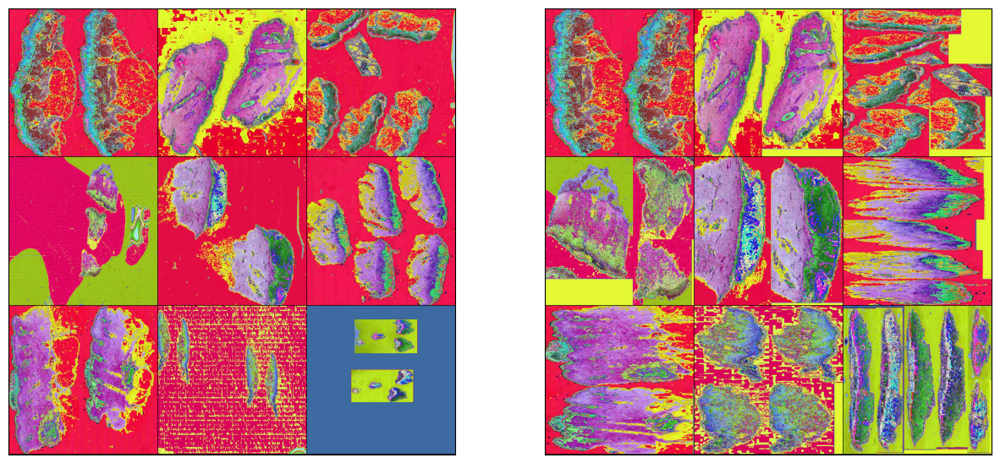

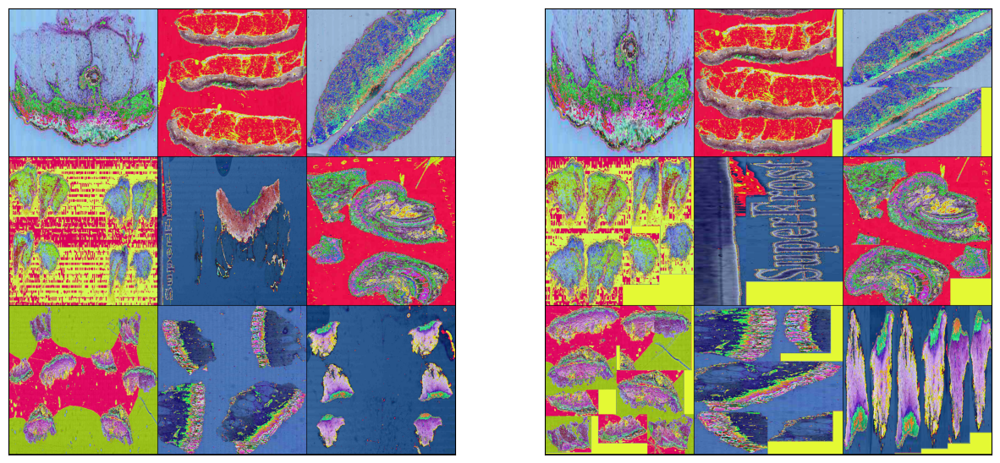

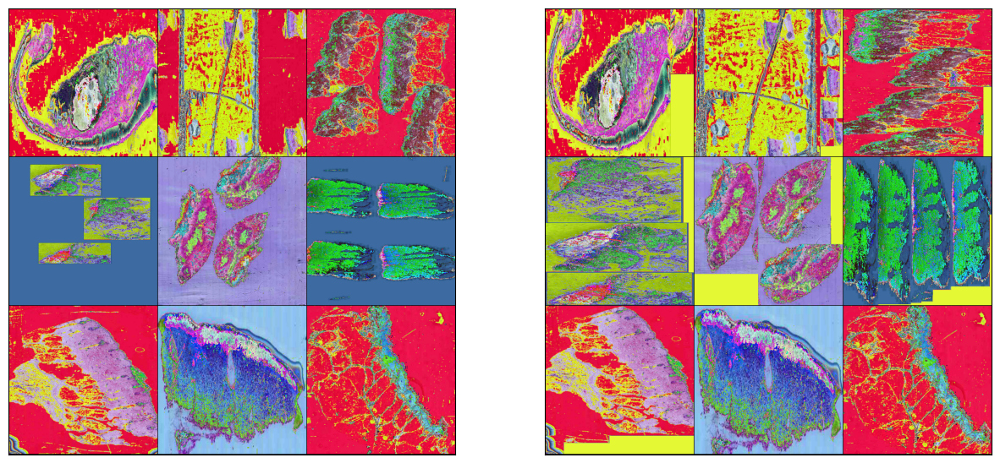

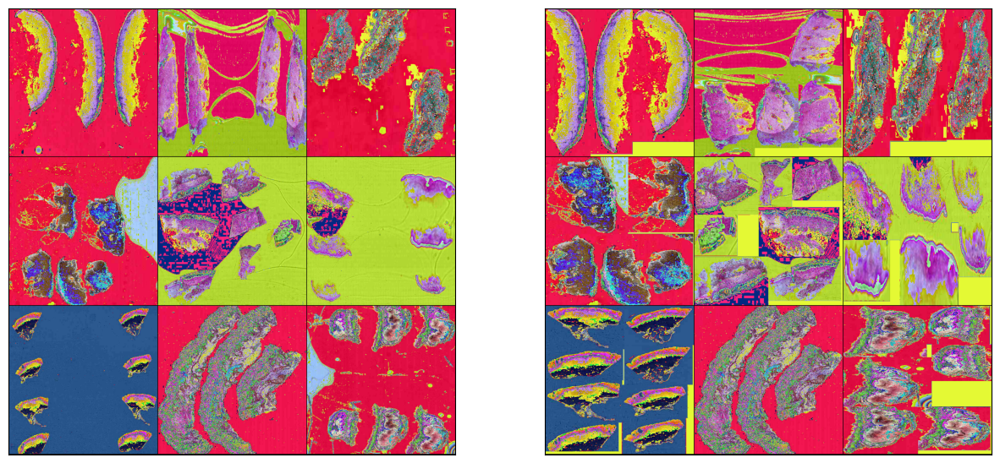

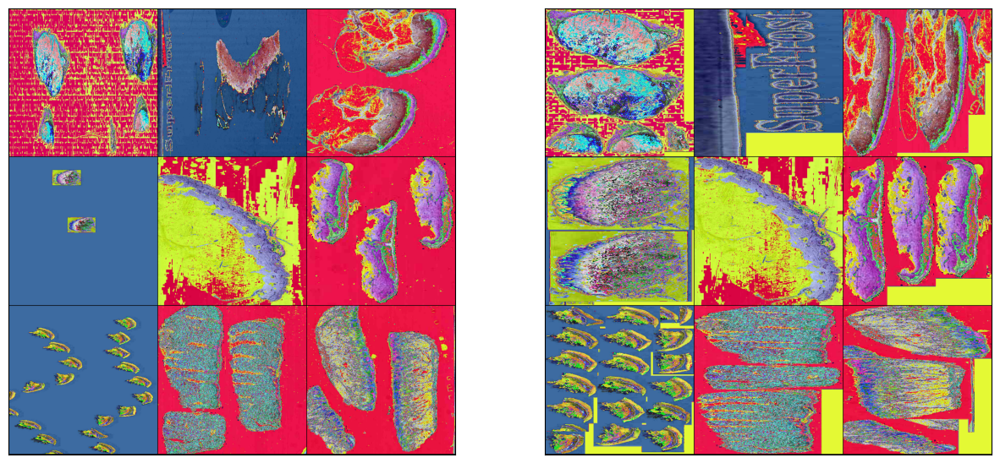

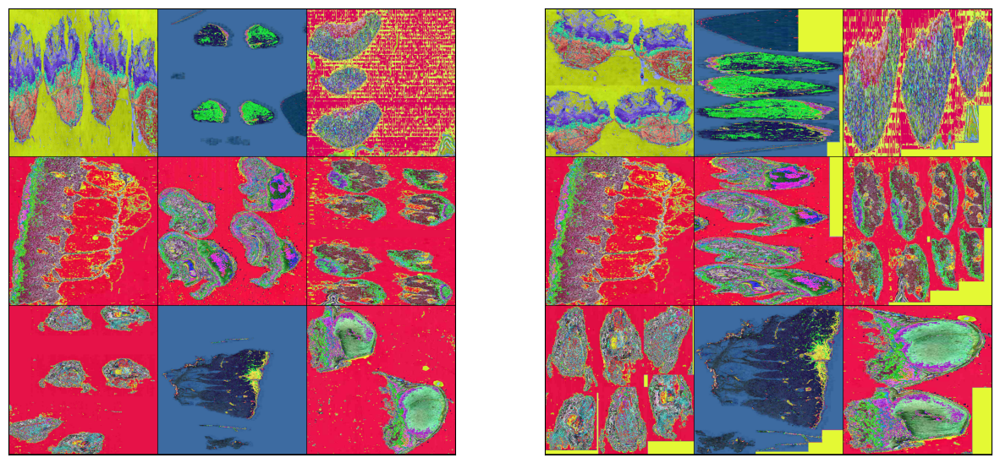

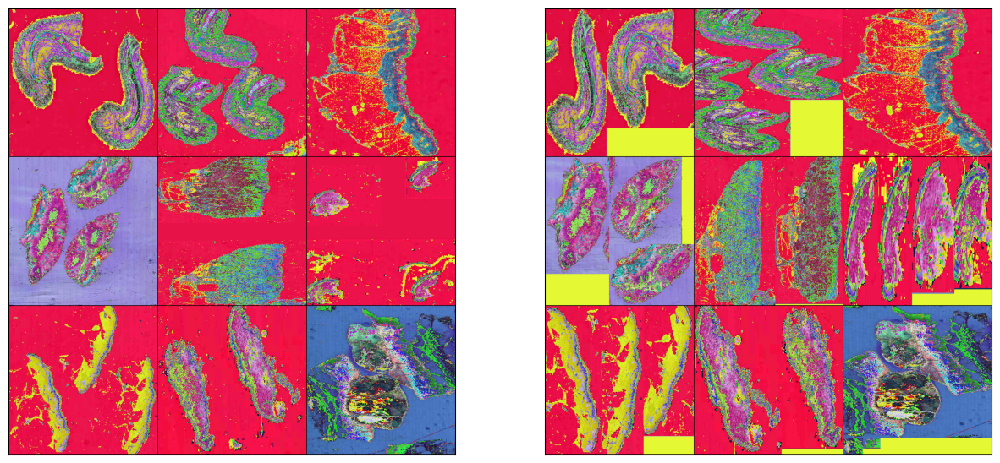

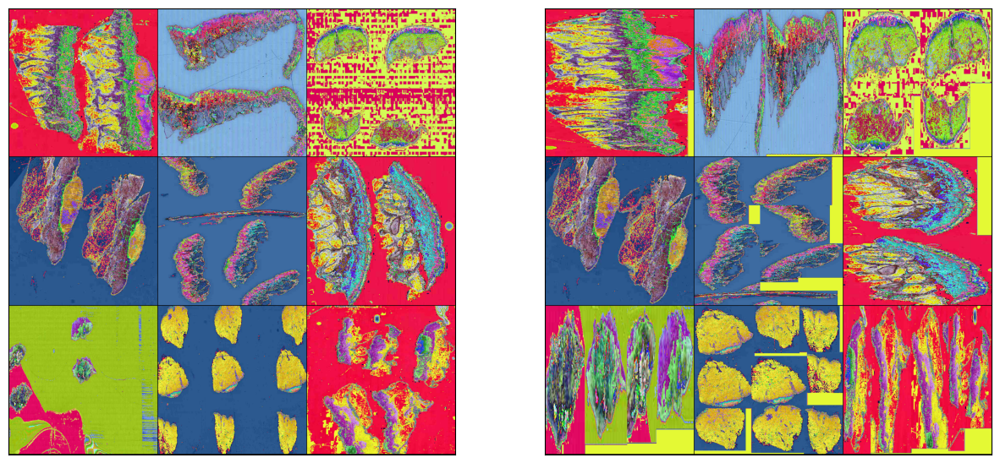

In [38]:
for sample in filenames_sample:
    images = [t_raw(Image.open(filename)) for filename in sample]
    images_shrinked = [t_shrink(Image.open(filename)) for filename in sample]

    grid = make_grid(images, nrow=3)
    grid_shrinked = make_grid(images_shrinked, nrow=3)

    names = [str(x.stem) for x in sample]
    print(names)
    show([grid, grid_shrinked])

['2mivi1li', 'yy0szf2e', 'k9jn7pdi', 'o6qbfsgz', '08iwwo8m', 'jg5exovl', 'bzfmf5v8', '0xqvhhhv', '05eq9f1y']
['4cyzecqy', 'drav1dv1', 'wibciyhg', '49crwssd', '7ut5a7t2', 'uj49228j', 'jooskyzv', 'uuggf1s7', '7x1hf8sh']
['qbc0z2sl', 'xiyoa66c', 'drav1dv1', 'w09gztun', 'eyfwsnwd', 'q4n9djkb', '9jclx9f7', 'hgxkiur9', 'eh408snl']
['70j26gp1', 'kg8k1bx3', 'pjrr6vxc', '3kfl6a36', 'oxk5y262', '8bt9si2a', 'qhw4vc8o', 'uucqw2cn', 'xsy0atf6']
['s4xs6gtk', 'rr4gq7zb', 'gawgxzga', 'f662smhw', '984x0rw9', '6jn7wrbc', 'i0aosocx', '9kdswl4l', 'xgrxhsxv']
['0jamx18o', 'uuggf1s7', 'bzfmf5v8', 'retnlce0', 'jb68woac', 'ussw5ei1', 'vhbby3u4', 'nv7n6c5c', 'x82yrtsb']
['jvghvndp', 'oxk5y262', 'e3xwx1iz', 'lrbcgqxg', 'shk81e70', 'd71zazk9', 'sy3z8ynh', 'jr32nvbx', '1n705ef8']
['3jrrivie', 'qrimite8', 'v47a2cp5', '1ojip5y7', '45u3in6d', 'aiv94oe5', 'jxro26uk', 'o2vpwyez', '5vg96jxq']
['mn1uc7ly', 'sycpjk8q', 'yh4wyluf', '984x0rw9', 'sp14j73t', '6t5gt51a', '9zooe7y1', 'dbdfsmgk', '3j7c1ors']
['ub642c2t', '38daj

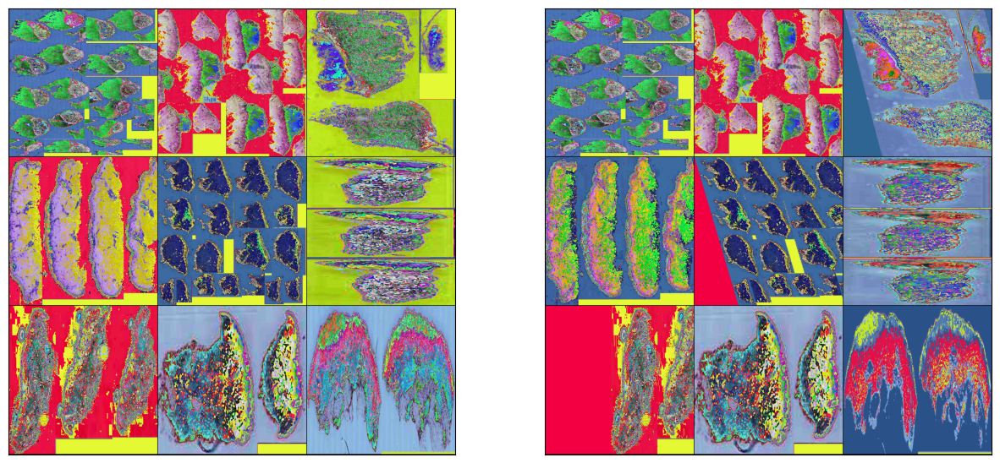

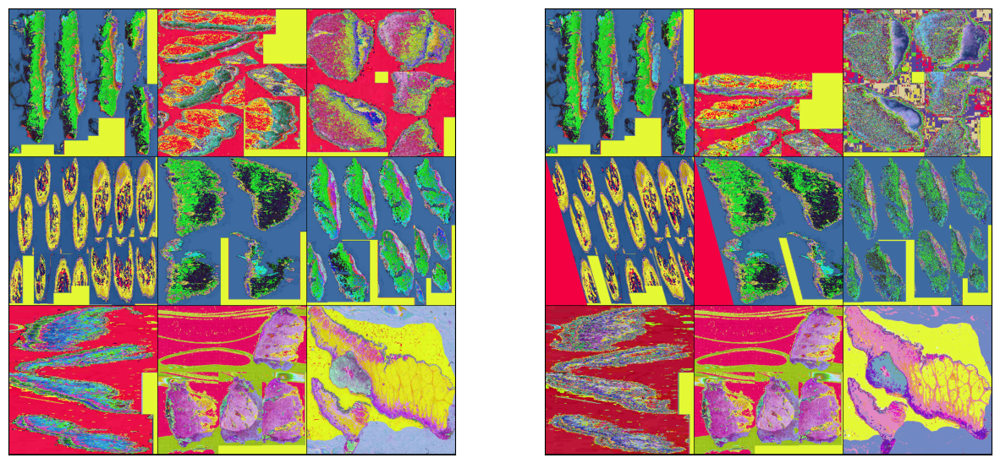

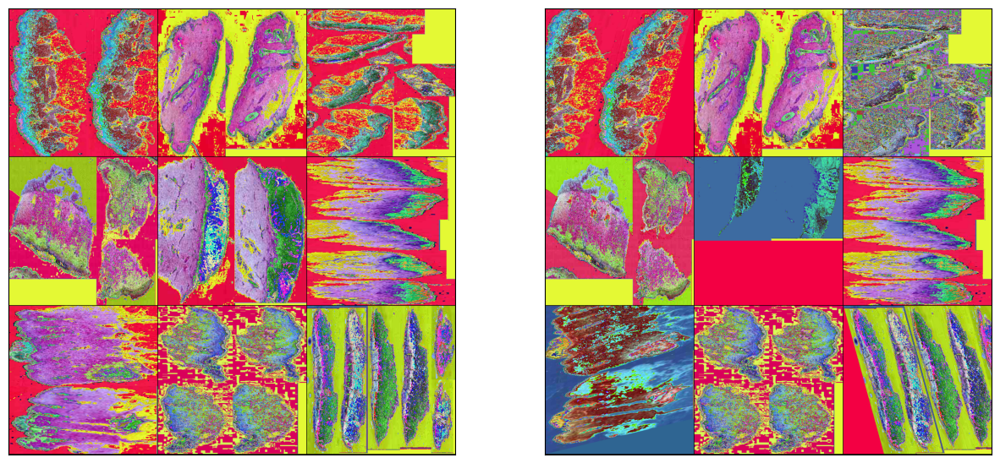

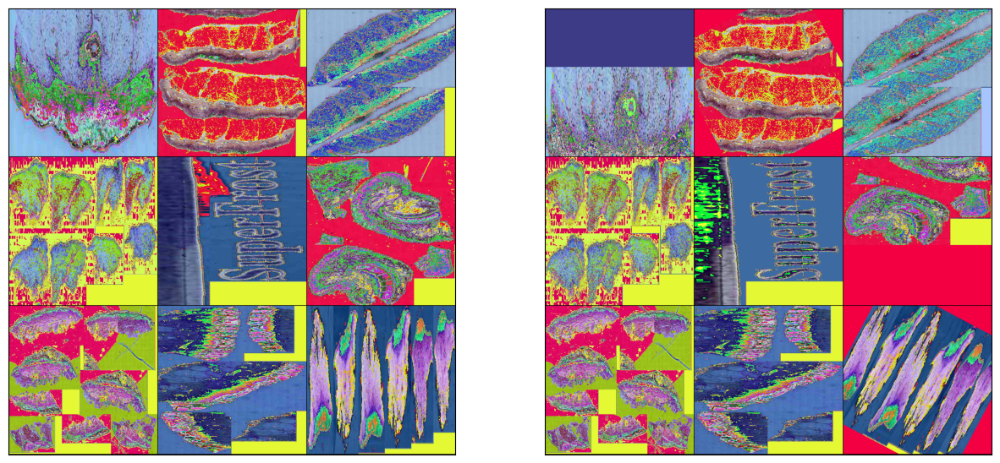

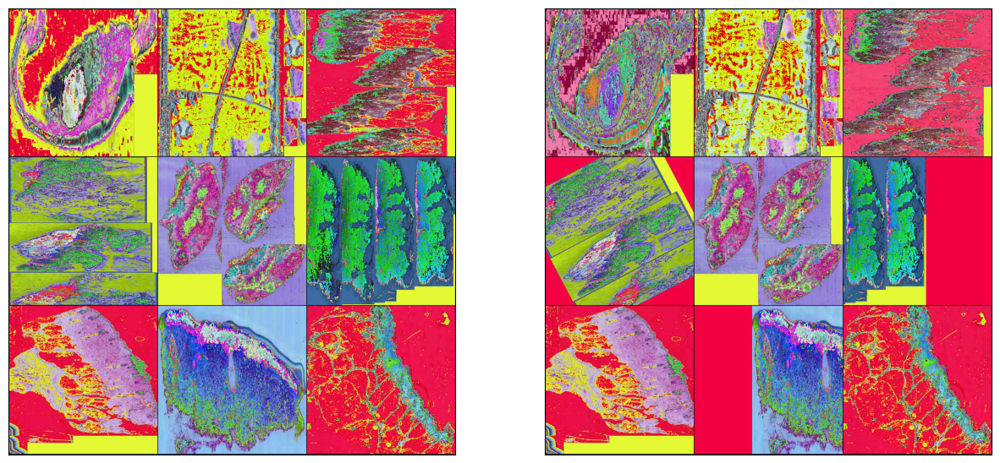

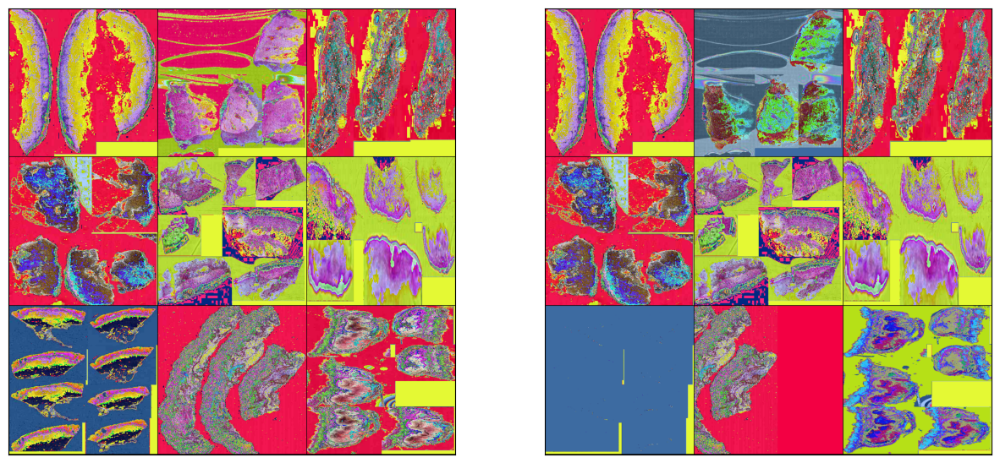

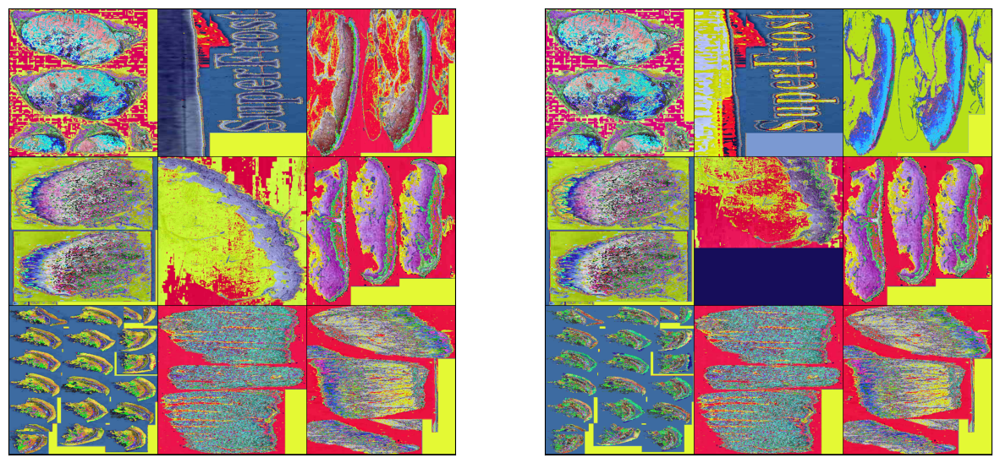

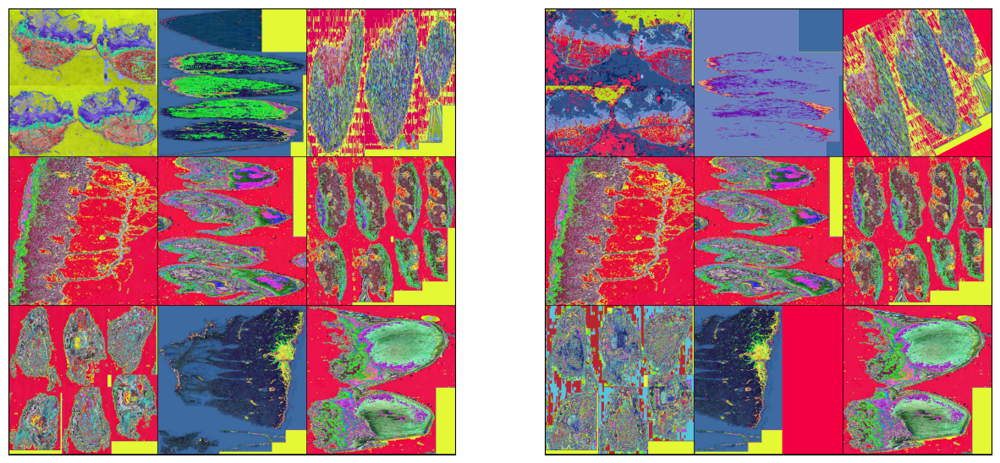

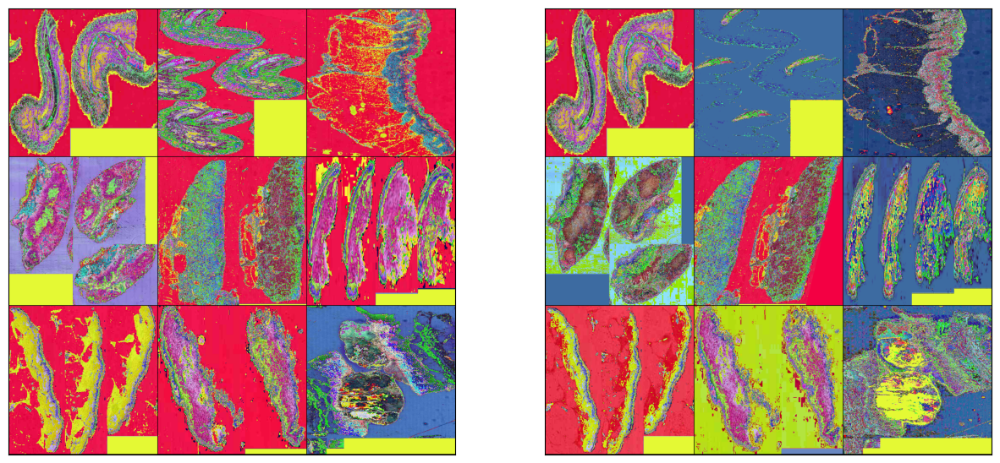

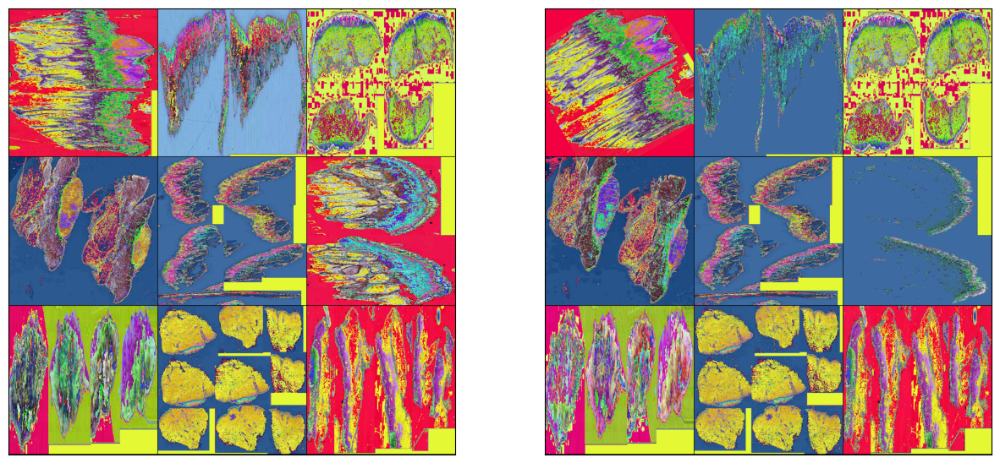

In [39]:
for sample in filenames_sample:
    images_shrinked = [t_shrink(Image.open(filename)) for filename in sample]
    images_aug = [t_aug(Image.open(filename)) for filename in sample]

    grid_shrinked = make_grid(images_shrinked, nrow=3)
    grid_aug = make_grid(images_aug, nrow=3)

    names = [str(x.stem) for x in sample]
    print(names)
    show([grid_shrinked, grid_aug])

In [ ]:
t_shrink = Compose(
    [
        CenterCropPct(size=(0.9, 0.9)),
        Shrink(scale=None),
        Resize(size=(img_size, img_size)),
        ToTensor(),
        Normalize(mean=[0.4850, 0.4560, 0.4060], std=[0.2290, 0.2240, 0.2250])
    ]
)